# Visualisation des données : Utilisation de Matplotlib, Seaborn, Plotly pour représenter des données avec Python

## Resources

Packages official documentation
- [Matplotlib](https://matplotlib.org/)
- [Seaborn](https://seaborn.pydata.org/)
- [Plotly](https://plotly.com/python/)
- [Dashboards](https://plotly.com/dash/)

Cheatsheets
- General
    - [plots_theory](https://www.psiweb.org/docs/default-source/2018-psi-conference-posters/48-julie-jones.pdf)
- Matplotlib
    - [Official matplotlib](https://github.com/matplotlib/cheatsheets)
        - [matplotlib 1.1](https://camo.githubusercontent.com/bc3b143766ed68eb6a851900c317c5d9222eb1471888942afb35137aa5141557/68747470733a2f2f6d6174706c6f746c69622e6f72672f63686561747368656574732f63686561747368656574732d312e706e67)
        - [matplotlib 2.1](https://camo.githubusercontent.com/8566d191963c2ada58246241d19a1252c519edea1ecf4049f5bc939e302e36a8/68747470733a2f2f6d6174706c6f746c69622e6f72672f63686561747368656574732f63686561747368656574732d322e706e67)
        - [matplotlib for beginners](https://camo.githubusercontent.com/b1b8838502a81077591ccadbf45dc45f2207637b41245e557198b680b0a2e662/68747470733a2f2f6d6174706c6f746c69622e6f72672f63686561747368656574732f68616e646f75742d626567696e6e65722e706e67)
    - By Datacamp
        - [matplotlib](https://s3.amazonaws.com/assets.datacamp.com/blog_assets/Python_Matplotlib_Cheat_Sheet.pdf)
        - [seaborn](https://s3.amazonaws.com/assets.datacamp.com/blog_assets/Python_Seaborn_Cheat_Sheet.pdf)
- Interactive graphs:
    - [plotly](https://images.plot.ly/plotly-documentation/images/python_cheat_sheet.pdf)
    

## Table des matières
- [ressources](#ressources)
- [Démonstrations](#démonstrations-dutilisation-simple-de-matplotlib-seaborn-et-plotly)
- [Couleurs](#couleurs---coloration-des-points-de-données)
- [plots](#scatter-plot)



## Démonstrations d'utilisation simple de Matplotlib, Seaborn et Plotly

In [402]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [403]:
# Data
np.random.seed(10)
x = range(1000)
y = np.random.randn(1000)
z = np.random.randn(1000)
cat = np.random.randint(low=0, high=3, size=1000)
colors = np.random.randint(low=0, high=5, size=1000)

df = pd.DataFrame({'x': x, 'y': y, 'colors': colors, 'cat': cat})

In [404]:
df

,x,y,colors,cat
0,0,1.331587,2,0
1,1,0.715279,3,2
2,2,-1.545400,1,2
3,3,-0.008384,1,1
4,4,0.621336,1,1
...,...,...,...,...
995,995,-1.014339,4,1
996,996,-0.331828,4,1
997,997,1.440697,0,1
998,998,-0.390218,3,2


**Rappel Pandas DataFrames**

L'utilisation de `masks` avec les **DataFrames** est un moyen efficace, clair et polyvalent pour **filter** des données

In [405]:
# Création d'un premier masque (vecteur booléen, i.e. True/False)
y_neg = df['y'] < 0
y_neg

0      False
1      False
2       True
3       True
4      False
       ...  
995     True
996     True
997    False
998     True
999    False
Name: y, Length: 1000, dtype: bool

In [406]:
# Création d'un second masque
cat_2 = df['cat'] == 2
cat_2

0      False
1       True
2       True
3      False
4      False
       ...  
995    False
996    False
997    False
998     True
999     True
Name: cat, Length: 1000, dtype: bool

In [407]:
# Utilisation des masques pour obtenir les données filtrées
df[y_neg & cat_2]

,x,y,colors,cat
2,2,-1.545400,1,2
9,9,-0.174600,4,2
12,12,-0.965066,1,2
19,19,-1.079805,0,2
30,30,-0.267317,2,2
...,...,...,...,...
971,971,-0.625302,4,2
987,987,-0.942393,2,2
991,991,-1.894594,2,2
994,994,-0.160357,3,2


### Graphiques fondamentaux bruts

#### Line chart

Matplotlib

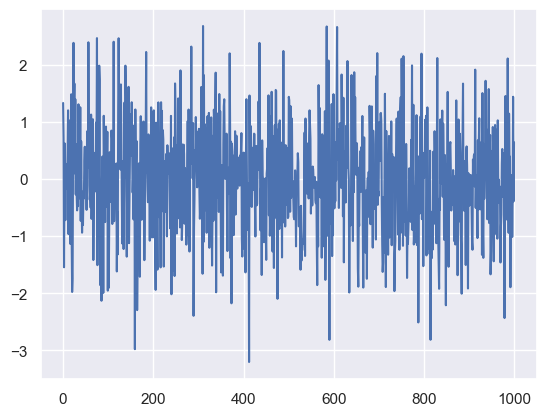

In [408]:
# From matplotlib.pyplot directly
plt.plot(y)

<AxesSubplot:xlabel='x'>

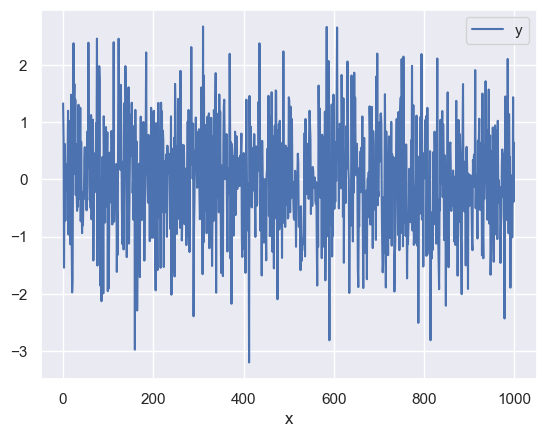

In [409]:
# From Pandas DataFrames
df.plot('x', 'y')

Seaborn

<AxesSubplot:xlabel='x', ylabel='y'>

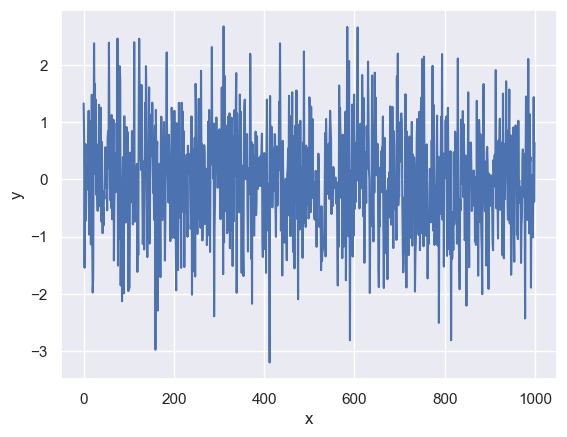

In [410]:
# Activate Seaborn nice theme (will also be activated for standard matplotlib graphs)
sns.set_theme()
sns.lineplot(data=df, x='x', y='y')

Plotly

In [411]:
# You can zoom and hover with the mouse to see data values
px.line(df, 'x', 'y')

#### Scatter plot

Matplotlib

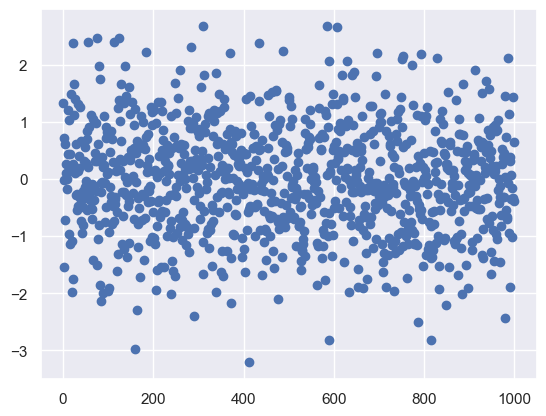

In [412]:
# From matplotlib.pyplot directly
plt.scatter(x, y)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


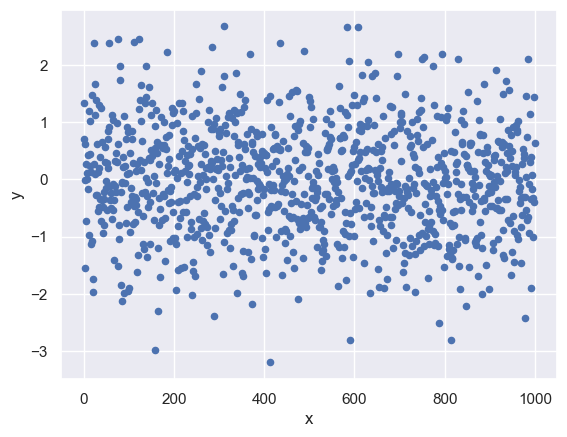

In [413]:
# From Pandas DataFrames
df.plot.scatter('x', 'y');

Seaborn

<AxesSubplot:xlabel='x', ylabel='y'>

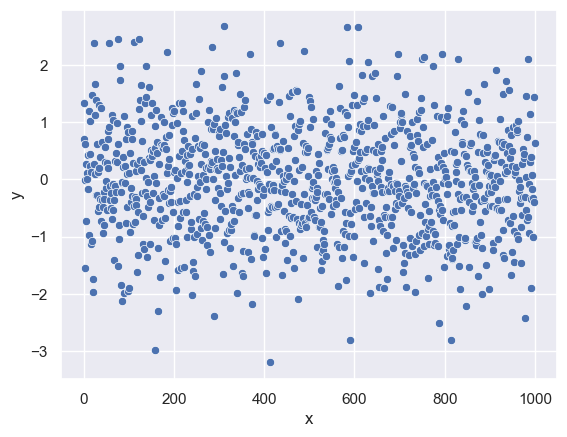

In [414]:
sns.scatterplot(data=df, x='x', y='y')

Plotly

In [415]:
px.scatter(df, x='x', y='y')

#### [Histogram](#resources)

Matplotlib

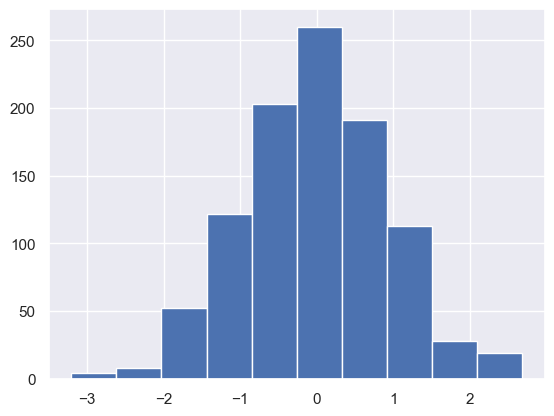

In [416]:
# From matplotlib.pyplot directly
plt.hist(y);

<AxesSubplot:>

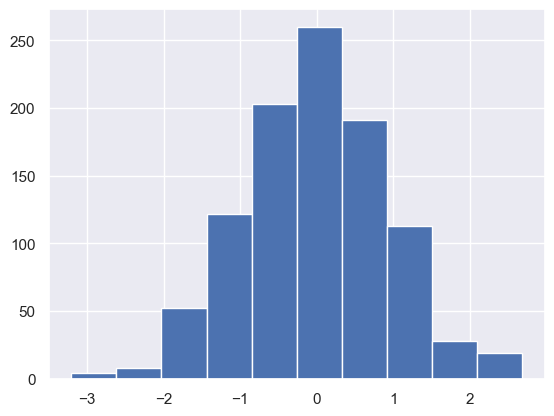

In [417]:
# From Pandas DataFrames
df['y'].hist()

Seaborn

<AxesSubplot:xlabel='y', ylabel='Count'>

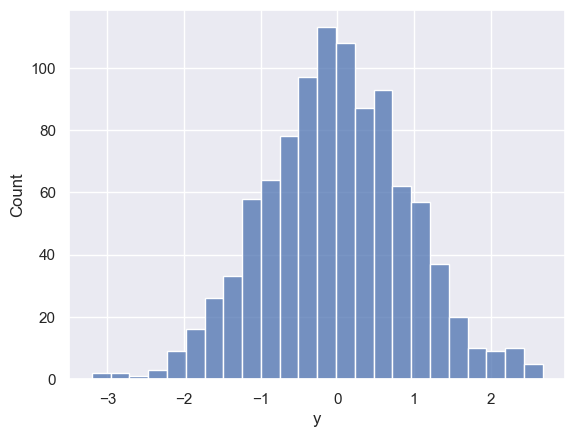

In [418]:
sns.histplot(df['y'])

Plotly

In [419]:
px.histogram(df['y'])

### Couleurs - Coloration des points de données

**Couleurs** et `palettes` utilisables avec Matplotlib sur [matplotlib.org](https://matplotlib.org/stable/users/explain/colors/colors.html)

#### Définition des couleurs pour **chaque** point de données

In [420]:
# Data
import random

colors_1 = ['g'] * 50 + ['b'] * 450 + ['r'] * 500
colors_2 = random.choices(['b', 'r', 'g'], k=1000)

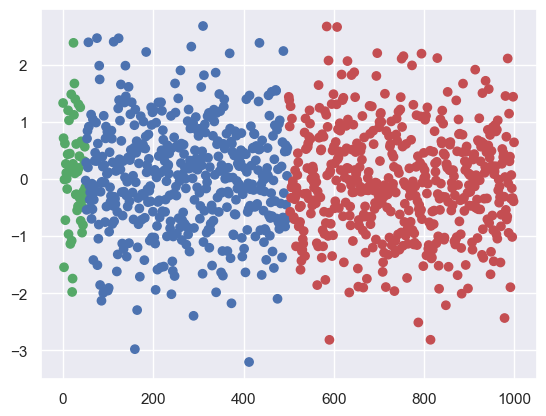

In [421]:
# From matplotlib.pyplot directly
plt.scatter(x, y, c=colors_1)

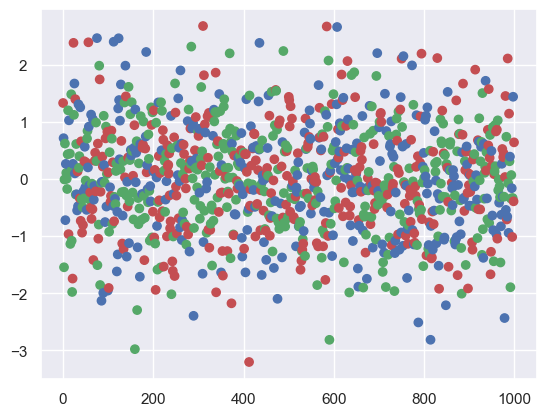

In [422]:
# From matplotlib.pyplot directly
plt.scatter(x, y, c=colors_2)

Comment est-ce que cela fonctionne ?
- La couleur est attribuée en fonction de sa **position** dans la liste
- Si un point de données (ici le chiffre 4) est en 3e position [9, 3, 4, 5, 8], alors la couleur qui lui sera attribuée sera en 3e position de la list des couleurs
- *ex : ['b', 'b', 'r', 'b', 'b']*

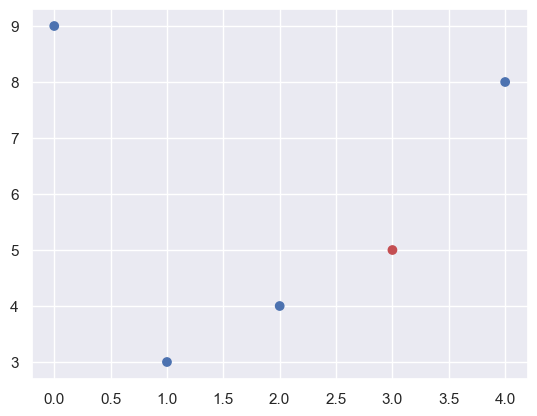

In [423]:
# Example simple
x_small = [0, 1, 2, 3, 4]
y_small = [9, 3, 4, 5, 8]
colors = ['b', 'b', 'b', 'r', 'b']
plt.scatter(x_small, y_small, c=colors)

#### Définition des couleurs de manière automatique

Utilisation des `gradients` et `palettes` de couleurs

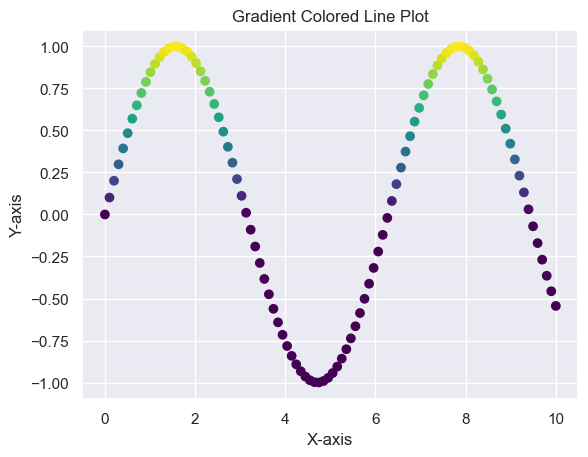

In [424]:
# Gradient

# Generating data
x1 = np.linspace(0, 10, 100)
y1 = np.sin(x1)

# Creating a figure and axis
fig, ax = plt.subplots()

# Creating a color gradient for the line
cmap = plt.get_cmap('viridis')
colors = cmap(y1)

# Plotting the line with gradient color
ax.scatter(x1, y1, color=colors)

# Setting labels and title
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_title('Gradient Colored Line Plot')

plt.show()


Recommandations **matrices de corrélations**
- Utiliser une palette de couleurs `divergente`: [lien palettes de couleurs](https://matplotlib.org/stable/users/explain/colors/colormaps.html)
- Fixer les valeurs min et max à -1 et 1

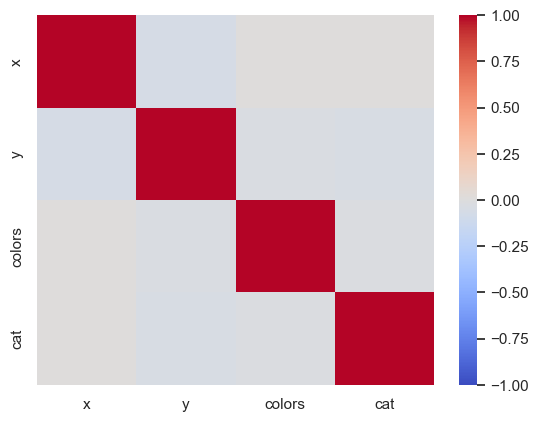

In [425]:
sns.heatmap(df.corr(), cmap='coolwarm', vmin=-1, vmax=1);

### Taille des points de données

In [426]:
# Data
sizes_1 = [10] * 500 + [40] * 500
sizes_2 = random.choices([10, 40], k=1000)

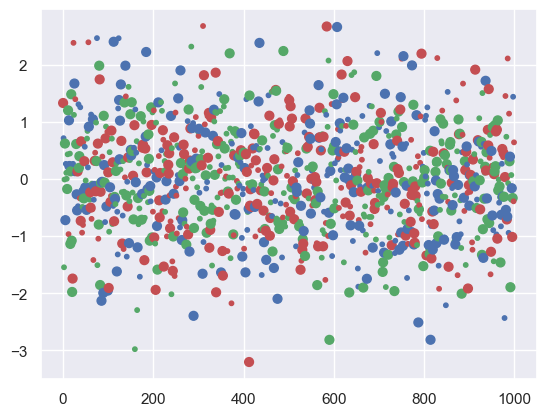

In [427]:
# From matplotlib.pyplot directly
plt.scatter(x, y, c=colors_2, s=sizes_2)

Comment est-ce que cela fonctionne ?
- De même que les couleurs, l'attribution dépend de la position relative dans la liste

### Markers - Type / forme des points de données

#### Marker identique sur l'ensemble des points

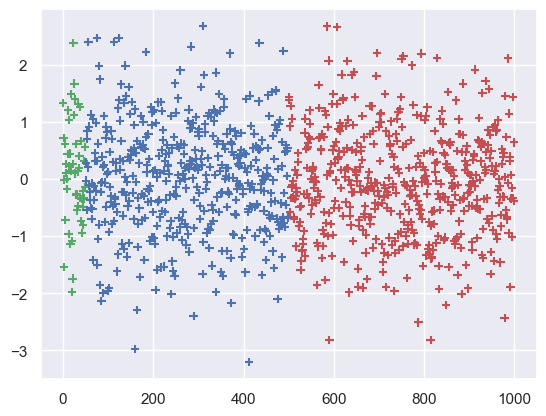

In [428]:
# From matplotlib.pyplot directly
plt.scatter(x, y, c=colors_1, marker='+')

#### Multiples markers
- Solution 0 (ne fonctionne pas) : définir une liste de markers
- Solution 1 (ne pas faire car inefficient) : plotter chaque point les uns après les autres
- Solution 2 : plotter un nouveau graph (avec ses points correspondants) pour chaque marker

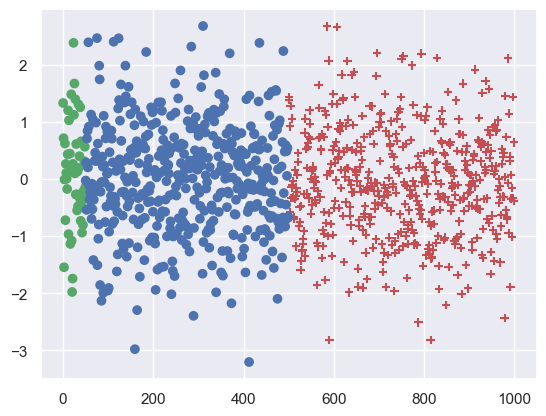

In [429]:
# Solution 2
plt.scatter(x[500:], y[500:], c=colors_1[500:], marker='+')
plt.scatter(x[:500], y[:500], c=colors_1[:500], marker='o')

## Graphiques spécifiques à chaque package

#### Matplotlib

- `Matplotlib` permet de faire n'importequel type de graph, puisqu'il s'agit de la boîte à outil sur laquelle repose Seaborn.
- Il est donc possible de reproduire les graphs de `Seaborn` en utilisant Matplotlib uniquement, mais cela demande bien plus d'efforts.
- Pour `plotly` c'est différent, puisque le package repose sur plotly.js, écrit en javascript.
- Inutile de s'y attaquer avec matplotlib. Par contre, leur forme en version statique pourra toujours être reproduite en matplotlib pur, avec une bonne volonté.

#### Seaborn

**Pairplot**
- Scatter plots sur les matrices triangulaires inférieures et supérieures
- Histogrammes sur la diagonale

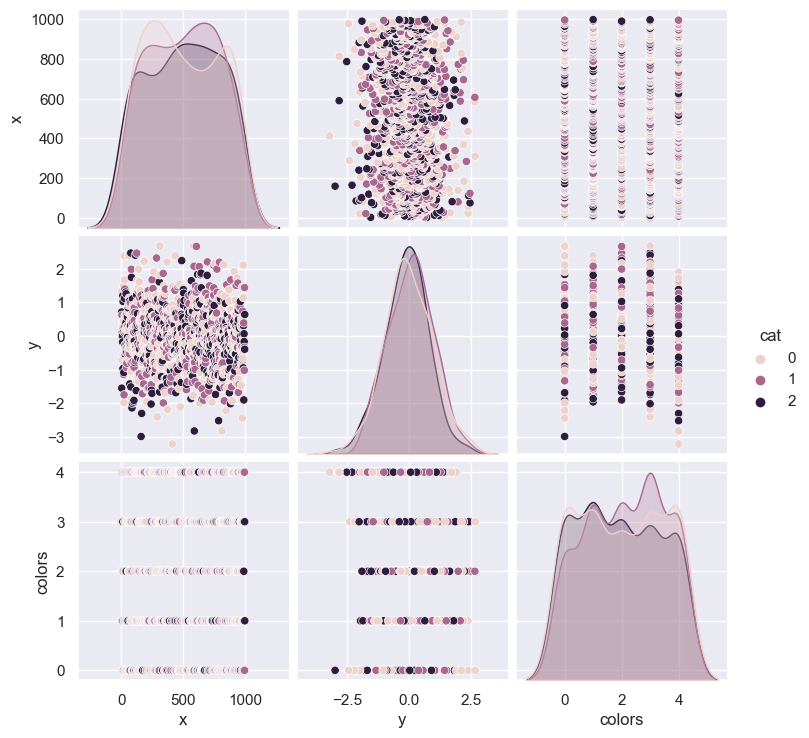

In [430]:
sns.pairplot(df, hue='cat', height=2.5);

**Regplot**
- Génère une régression linéaire avec intervalle de confiance
- Il n'est cependant pas possible de récupérer les paramètres de la régression

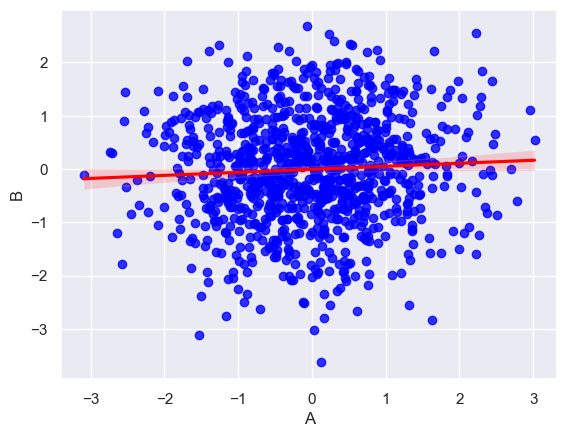

In [431]:
# Dataframe of a generated financial series
df2 = pd.DataFrame(np.random.randn(1000, 4), index=pd.date_range('1/1/2000', periods=1000), columns=list('ABCD'))

# Seaborn regplot
sns.regplot(data=df2, x='A', y='B', scatter_kws={'color': 'blue'}, line_kws={'color': 'red'});

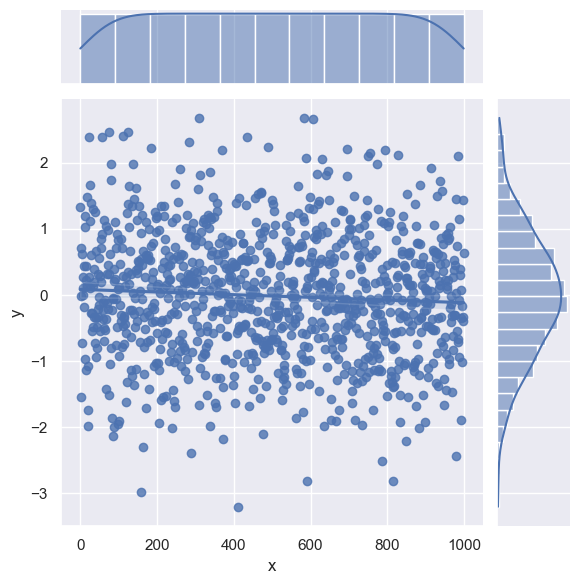

In [432]:
g = sns.jointplot(x="x", y="y", kind="reg", data=df) 

- [Equivalent pairplot avec matplotlib](https://www.endpointdev.com/blog/2022/04/visualizing-data-with-pairplot-using-matplotlib/)
- [Equivalent jointplot avec matplotlib](https://matplotlib.org/stable/gallery/lines_bars_and_markers/scatter_hist.html#sphx-glr-gallery-lines-bars-and-markers-scatter-hist-py)

#### Plotly

Peut s'utiliser avec deux modules différents :
- `plotly.express` : graphs par défaut simples et efficaces
- `plotly.graph_objects` : davantage de possiblités / contrôle, un peu plus complexe

In [433]:
import plotly.express as px
import plotly.graph_objs as go

In [439]:
# Transformation (optionnelle) des chiffres en texte (0 par 'red', etc.)
color_map = {0:'red', 1:'white', 2:'blue', 3:'green', 4:'pink'}
cat_map = {0:'cat_0', 1:'cat_1', 2:'cat_2'}

df_text = df.copy()
df_text['colors'] = df_text['colors'].replace(color_map)
df_text['cat'] = df_text['cat'].replace(color_map)

In [440]:
fig = px.sunburst(df_text, path=['cat', 'colors'])
fig.show()

Aller plus loin:
- [plotly gallery](https://plotly.com/python/)

### Missingno

In [263]:
import missingno as msno

In [264]:
df_with_na = df.copy()

# Random
idx_to_add_na_x = np.random.randint(df.shape[0], size=100)

# Correlated
idx_to_add_na_colors = np.random.randint(df.shape[0], size=60)
idx_to_add_na_cat = np.random.choice(idx_to_add_na_colors, size=40)
# Negatively correlated
remaining_idx_choices = df_with_na.index.drop(idx_to_add_na_x)
idx_to_add_na_y = np.random.choice(remaining_idx_choices, size=100)

# Add nans
df_with_na.loc[idx_to_add_na_y, 'y'] = np.nan
df_with_na.loc[idx_to_add_na_x, 'x'] = np.nan
df_with_na.loc[idx_to_add_na_colors, 'colors'] = np.nan
df_with_na.loc[idx_to_add_na_cat, 'cat'] = np.nan

In [265]:
df_with_na

,x,y,colors,cat
0,0.0,NaN,2.0,0.0
1,1.0,0.715279,3.0,2.0
2,2.0,-1.545400,1.0,2.0
3,3.0,-0.008384,1.0,1.0
4,4.0,0.621336,1.0,1.0
...,...,...,...,...
995,995.0,-1.014339,4.0,1.0
996,996.0,-0.331828,4.0,1.0
997,997.0,NaN,0.0,1.0
998,998.0,-0.390218,3.0,2.0


In [311]:
df_with_na.isna().sum()

x         91
y         96
colors    59
cat       31
dtype: int64

<AxesSubplot:>

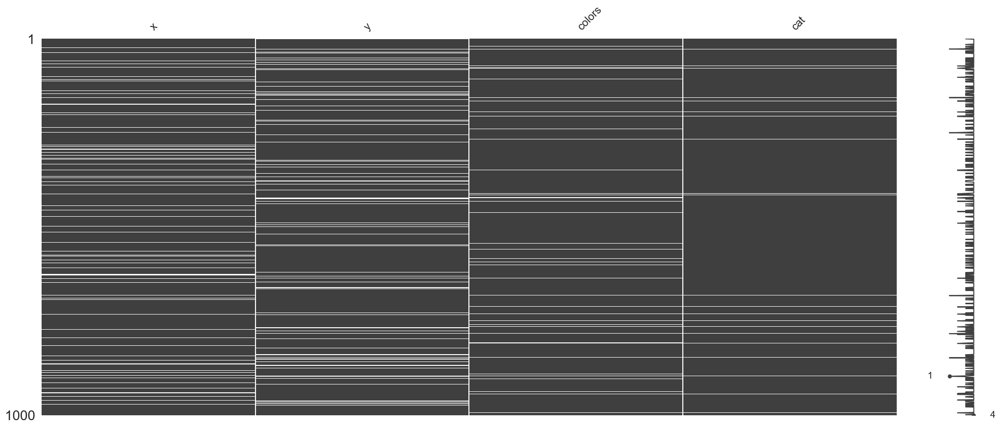

In [266]:
msno.matrix(df_with_na)

<AxesSubplot:>

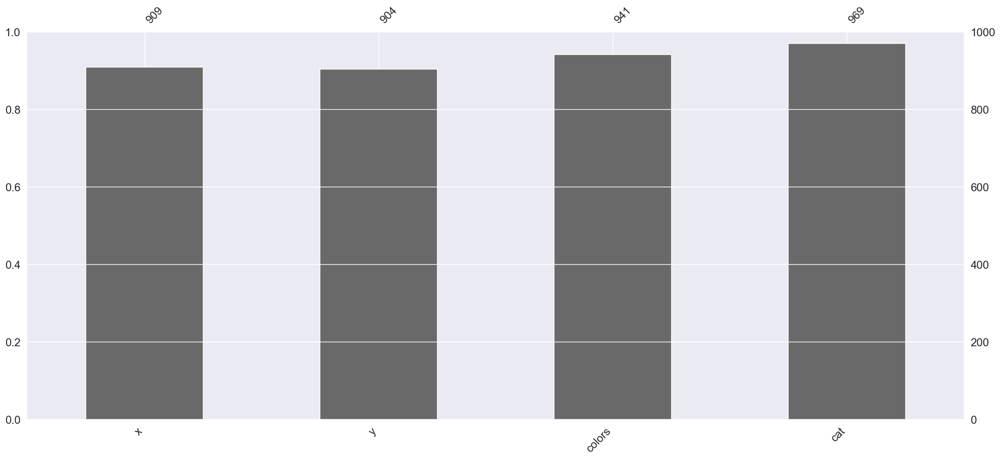

In [267]:
msno.bar(df_with_na)

<AxesSubplot:>

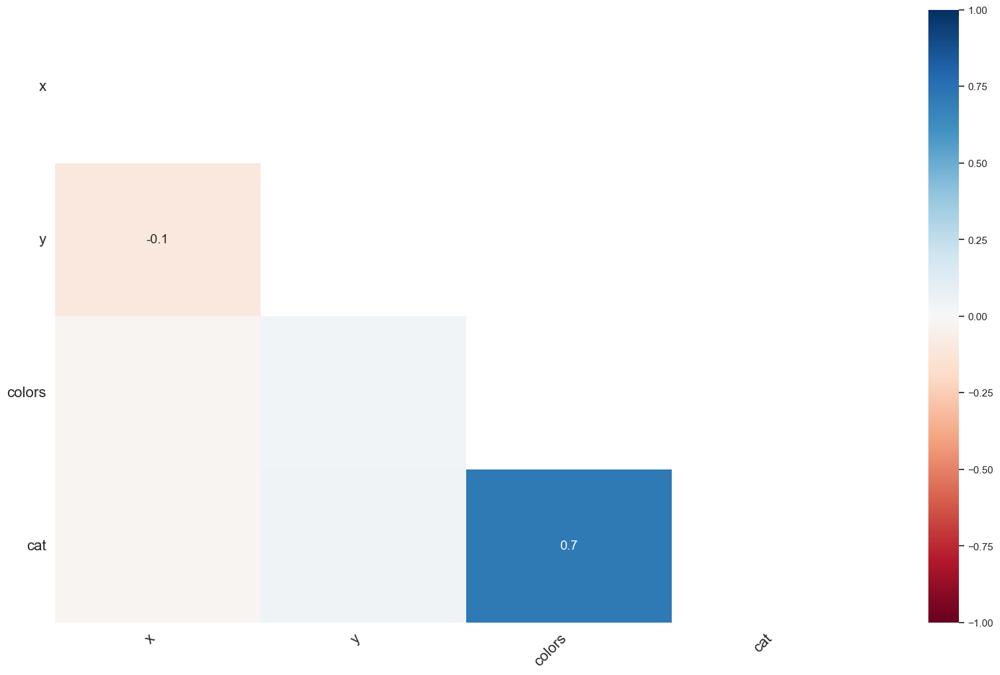

In [268]:
msno.heatmap(df_with_na)

<AxesSubplot:>

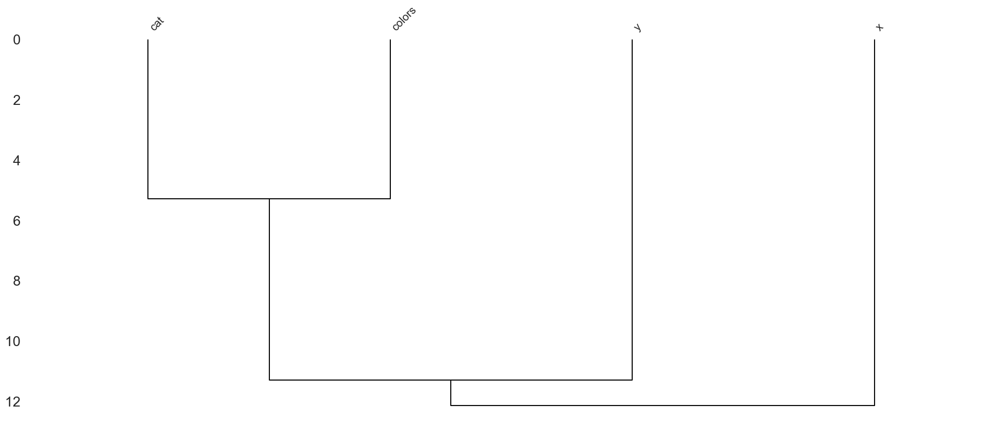

In [269]:
msno.dendrogram(df_with_na)

## Construction méthode manuelle
Permet davantage de flexibilité bien que moins facile à mettre en place

### Matplotlib

Création de la figure, puis des axes

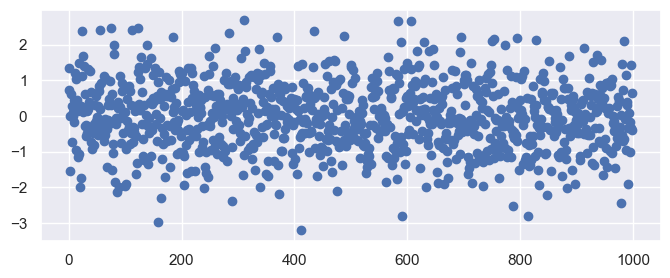

In [270]:
fig = plt.figure(figsize=(8, 3))
ax = fig.add_subplot(1, 1, 1)
ax.scatter(df['x'], df['y']);

Création de la figure et des axes en une commande

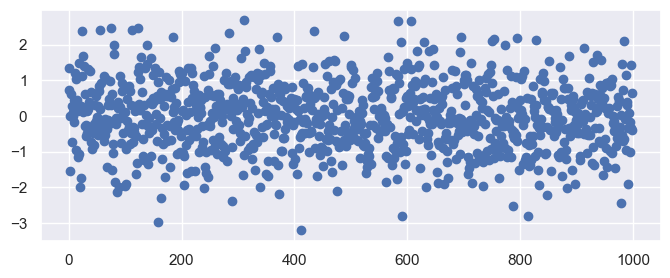

In [347]:
fig, axes = plt.subplots(1, 1, figsize=(8, 3))
axes.scatter(df['x'], df['y']);

### Plotly

Création de la figure, puis des axes

In [272]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=df['x'],
    y=df['y'],
    mode="markers+text",
    name="Markers and Text",
))

## Construction d'une grille de graphs

Attaquons nous directement aux grilles de graphs, cela permet également de comprendre comment se crée un graph plus simple en détail :
- Création d'une figure
- Création d'axes
- Génération d'un graph sur chaque axe

### Matplotlib

Création basique d'une figure avec plusieurs graphs "*subplots*"

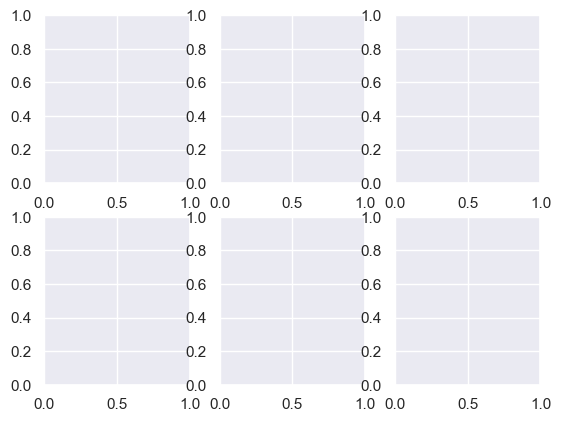

In [273]:
fig, axes = plt.subplots(2, 3)

Création basique d'une figure avec plusieurs graphs et une taille spécifique "*figsize*"

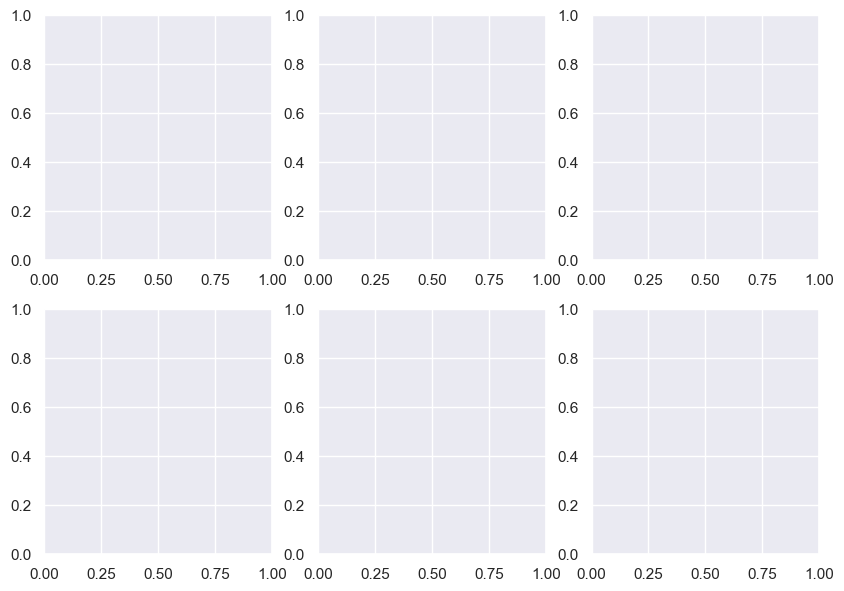

In [274]:
fig, axes = plt.subplots(2, 3, figsize=(10, 7))

Ajout d'un premier graph (en haut à gauche)

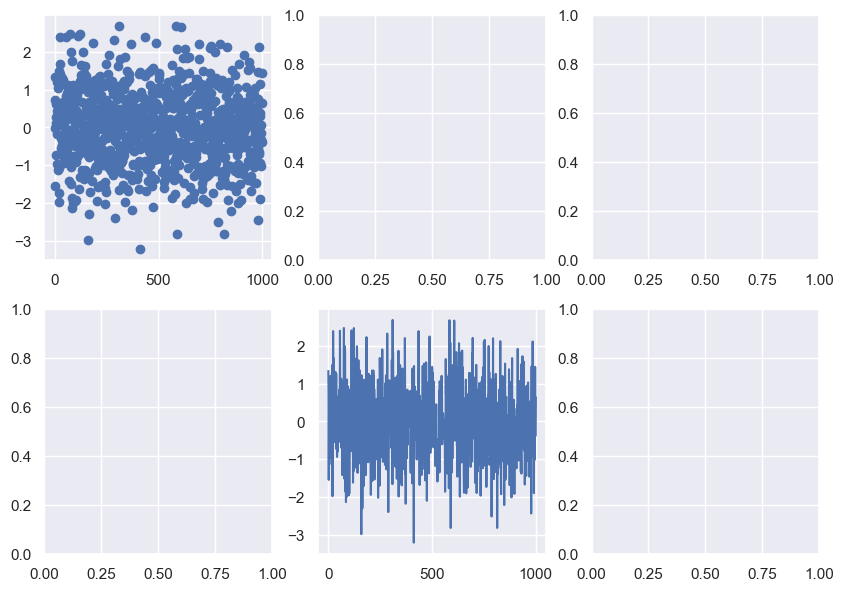

In [349]:
fig, axes = plt.subplots(2, 3, figsize=(10, 7))
axes[0, 0].scatter(x, y)
axes[1, 1].plot(x, y)

Ajout de plusieurs graphs

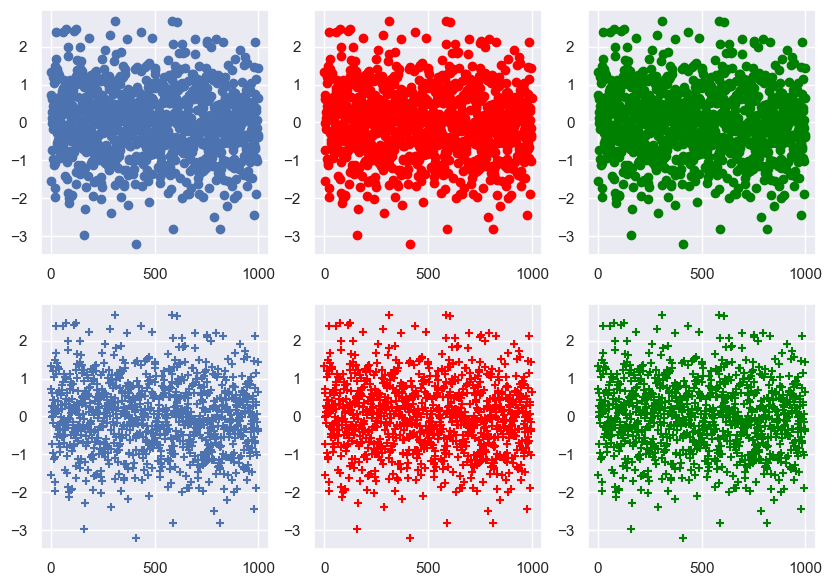

In [351]:
fig, axes = plt.subplots(2, 3, figsize=(10, 7))
# Plots on first row
axes[0, 0].scatter(x, y)
axes[0, 1].scatter(x, y, c='red')
axes[0, 2].scatter(x, y, c='green')
# Plots on second row
axes[1, 0].scatter(x, y, marker='+')
axes[1, 1].scatter(x, y, marker='+', c='red')
axes[1, 2].scatter(x, y, marker='+', c='green')

Ajout d'un titre, et de labels

Text(0, 0.5, 'location')

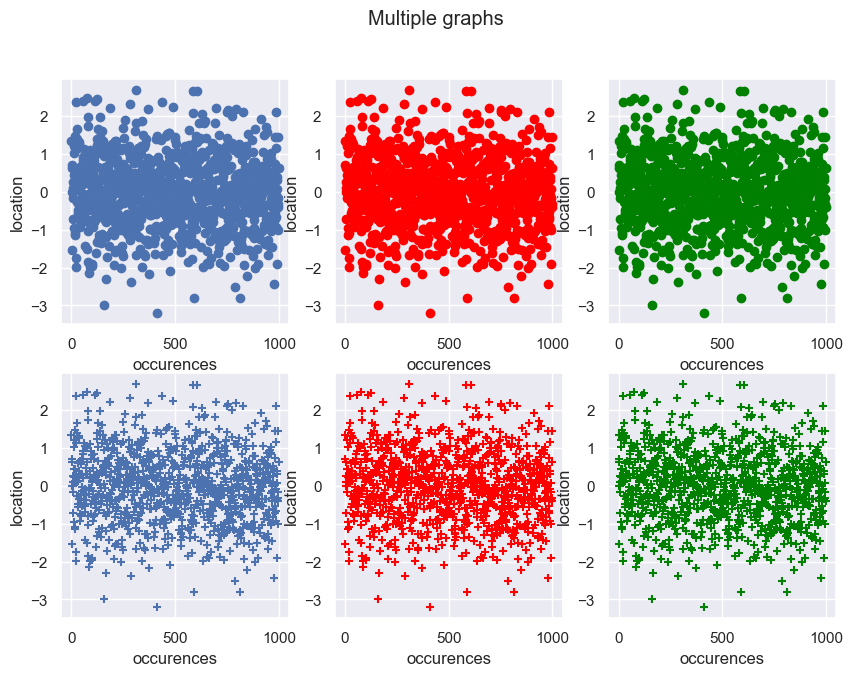

In [277]:
fig, axes = plt.subplots(2, 3, figsize=(10, 7))
# Plots on first row
axes[0, 0].scatter(x, y)
axes[0, 1].scatter(x, y, c='red')
axes[0, 2].scatter(x, y, c='green')
# Plots on second row
axes[1, 0].scatter(x, y, marker='+')
axes[1, 1].scatter(x, y, marker='+', c='red')
axes[1, 2].scatter(x, y, marker='+', c='green')

# Title 
fig.suptitle('Multiple graphs')

# Label 1 (for top left plot)
axes[0, 0].set_xlabel('occurences')
axes[0, 0].set_ylabel('location')
# Label 2
axes[0, 1].set_xlabel('occurences')
axes[0, 1].set_ylabel('location')
# Label 3
axes[0, 2].set_xlabel('occurences')
axes[0, 2].set_ylabel('location')
# Label 4
axes[1, 0].set_xlabel('occurences')
axes[1, 0].set_ylabel('location')
# Label 5
axes[1, 1].set_xlabel('occurences')
axes[1, 1].set_ylabel('location')
# Label 6
axes[1, 2].set_xlabel('occurences')
axes[1, 2].set_ylabel('location')

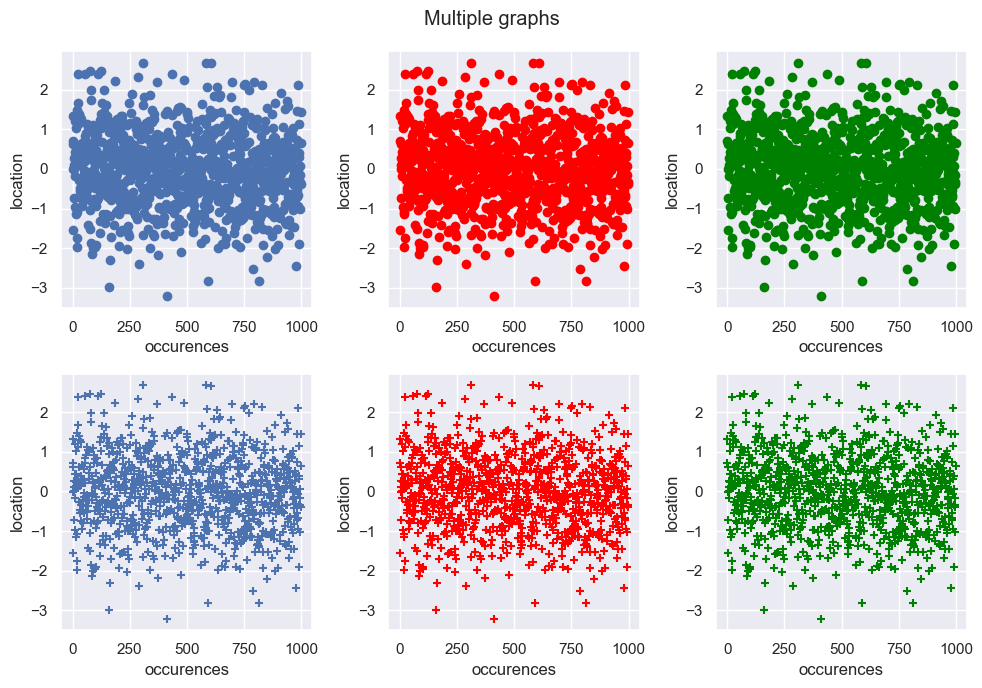

In [278]:
fig, axes = plt.subplots(2, 3, figsize=(10, 7))
# Plots on first row
axes[0, 0].scatter(x, y)
axes[0, 1].scatter(x, y, c='red')
axes[0, 2].scatter(x, y, c='green')
# Plots on second row
axes[1, 0].scatter(x, y, marker='+')
axes[1, 1].scatter(x, y, marker='+', c='red')
axes[1, 2].scatter(x, y, marker='+', c='green')

# Title 
fig.suptitle('Multiple graphs')

# Label 1 (for top left plot)
axes[0, 0].set_xlabel('occurences')
axes[0, 0].set_ylabel('location')
# Label 2
axes[0, 1].set_xlabel('occurences')
axes[0, 1].set_ylabel('location')
# Label 3
axes[0, 2].set_xlabel('occurences')
axes[0, 2].set_ylabel('location')
# Label 4
axes[1, 0].set_xlabel('occurences')
axes[1, 0].set_ylabel('location')
# Label 5
axes[1, 1].set_xlabel('occurences')
axes[1, 1].set_ylabel('location')
# Label 6
axes[1, 2].set_xlabel('occurences')
axes[1, 2].set_ylabel('location')

fig.tight_layout()

Partage d'axe entre les graphs: "*sharex*", "*sharey*"

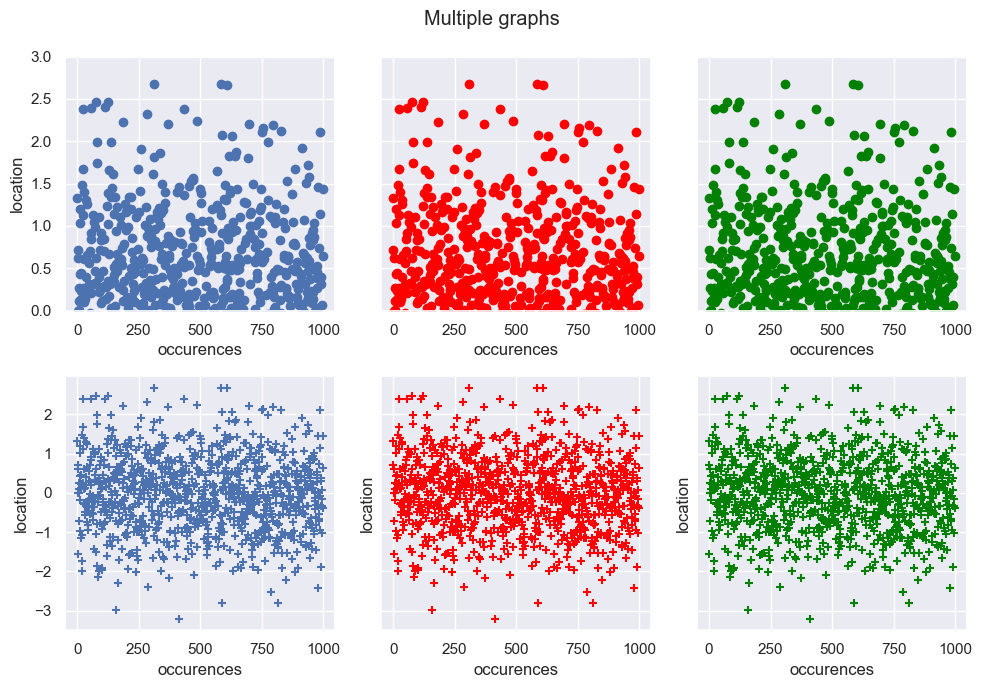

In [279]:
fig, axes = plt.subplots(2, 3, figsize=(10, 7), sharey='row')
# Plots on first row
axes[0, 0].scatter(x, y)
axes[0, 1].scatter(x, y, c='red')
axes[0, 2].scatter(x, y, c='green')
# Plots on second row
axes[1, 0].scatter(x, y, marker='+')
axes[1, 1].scatter(x, y, marker='+', c='red')
axes[1, 2].scatter(x, y, marker='+', c='green')

# Title 
fig.suptitle('Multiple graphs')

# Label 1 (for top left plot)
axes[0, 0].set_xlabel('occurences')
axes[0, 0].set_ylabel('location')
# croping the axis will benefit to other graphs in same row
axes[0, 0].set_ylim(0, 3)

# Label 2
axes[0, 1].set_xlabel('occurences')
# Label 3
axes[0, 2].set_xlabel('occurences')
# Label 4
axes[1, 0].set_xlabel('occurences')
axes[1, 0].set_ylabel('location')
# Label 5
axes[1, 1].set_xlabel('occurences')
axes[1, 1].set_ylabel('location')
# Label 6
axes[1, 2].set_xlabel('occurences')
axes[1, 2].set_ylabel('location')

fig.tight_layout()

### Seaborn

#### Approche manuelle

Une approche consiste à utiliser les *subplots* de *Matplotlib*, et d'y insérer des graphs constitués avec *Seaborn*

<AxesSubplot:>

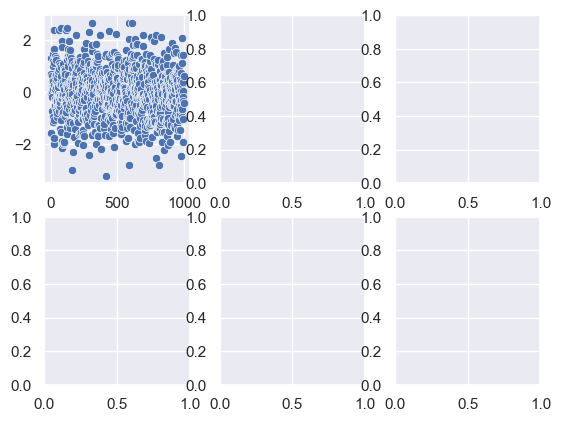

In [280]:
fig, axes = plt.subplots(2, 3)
sns.scatterplot(ax=axes[0, 0], x=x, y=y)

Avec l'utilisation d'une DataFrame plutôt que des Numpy arrays :
- x et y attendent les noms des colonnes de la DataFrame
- et non plus les séries de données comme dans l'exemple précédent

<AxesSubplot:xlabel='x', ylabel='y'>

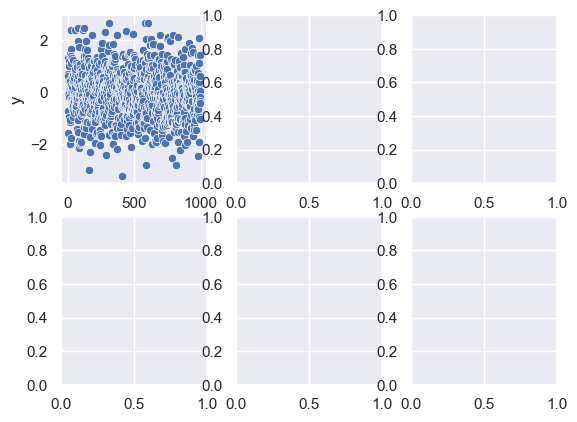

In [281]:
fig, axes = plt.subplots(2, 3)
sns.scatterplot(ax=axes[0, 0], data=df, x='x', y='y')

Création de `subplots` avec *Plotly*

In [ ]:
# Plotly subplot
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=2)

# Histogram subplot in red and green
fig.add_trace(go.Histogram(x=df['y'], marker_color='red'), row=1, col=1)
fig.add_trace(go.Histogram(x=df['y'], marker_color='green'), row=1, col=2)


#### Approche automatique

Une approche utilisant *Seaborn* repose sur l'utilisation des grilles *Faceted*
- Il s'agit d'un objet qui repose sur les subplots
- mais apporte des fonctionnalités pré-configurées

Il est possible d'utiliser ces grilles *Faceted* sans même les nommer
- en passant plus simplement par la fonction *relplot*
- elle se charge de créer la figure avec multiples cellules
- et d'y insérer les graphs correspondants

In [282]:
# Rappelez-vous des colonnes de notre DataFrame
df.head(3)

,x,y,colors,cat
0,0,1.331587,2,0
1,1,0.715279,3,2
2,2,-1.545400,1,2


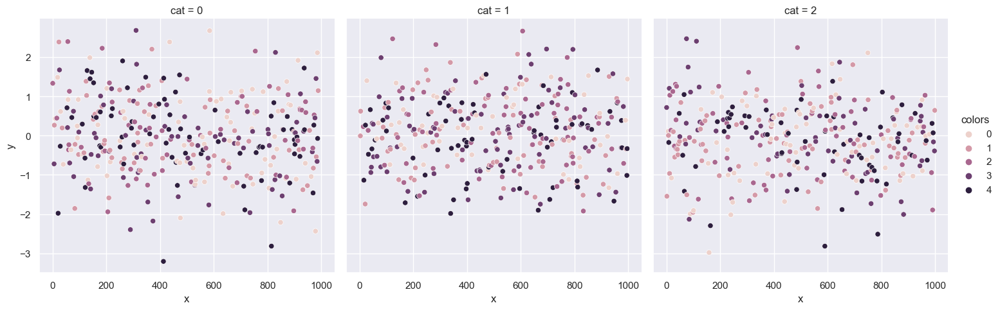

In [283]:
sns.relplot(data=df, x='x', y='y', hue='colors', col='cat')

Il est aussi possible d'obtenir un graph pour chaque paire de variables avec *pairplot*

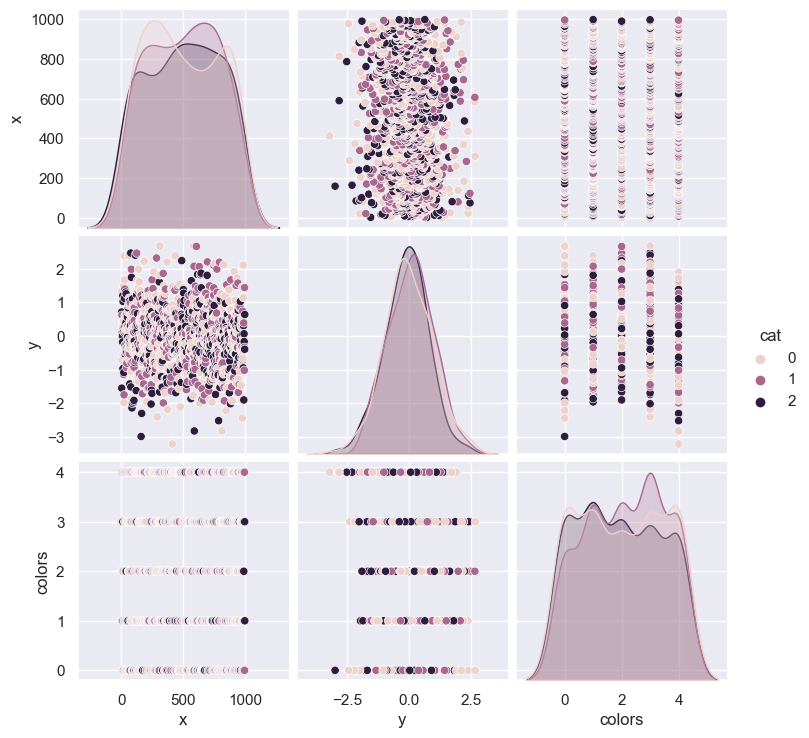

In [284]:
sns.pairplot(df, hue='cat', height=2.5)

#### Approche semi-automatique

Pour davantage de contrôle, il est possible d'utiliser :
- *"PairGrid"* pour présenter les relations de paires de variables
- *"FacetGrid"* pour présenter une même variables conditionnée par d'autres variables (groupby)

Il s'agit alors de décomposer en plusieurs étapes comme avec matplotlib:
- une première création de la grille
- l'attribution de graphs aux différentes parties de la grille

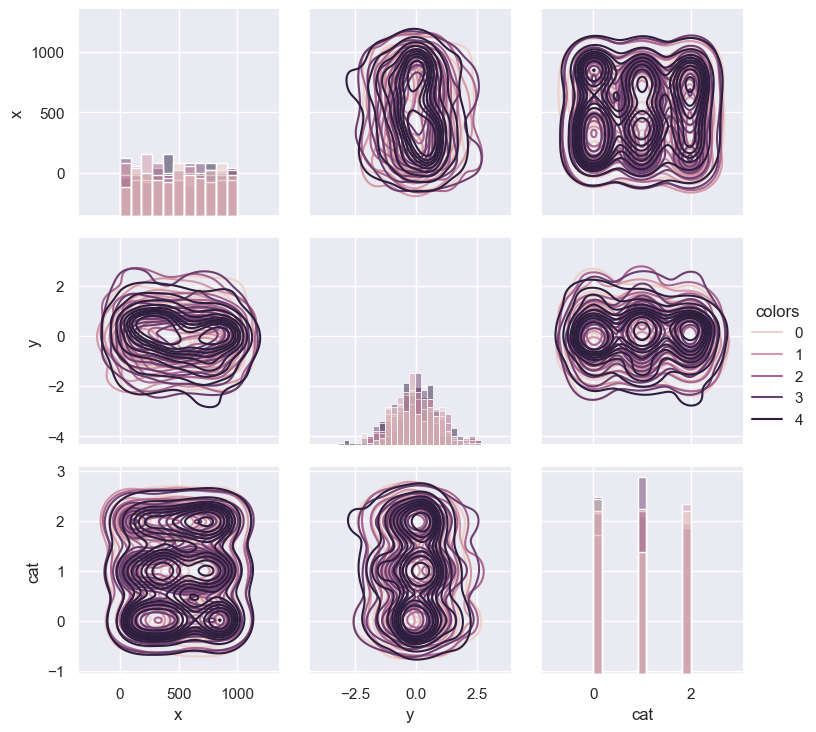

In [285]:
# Pour les paires de variables
g = sns.PairGrid(df, hue="colors")
g.map_diag(sns.histplot)
g.map_offdiag(sns.kdeplot)
g.add_legend()

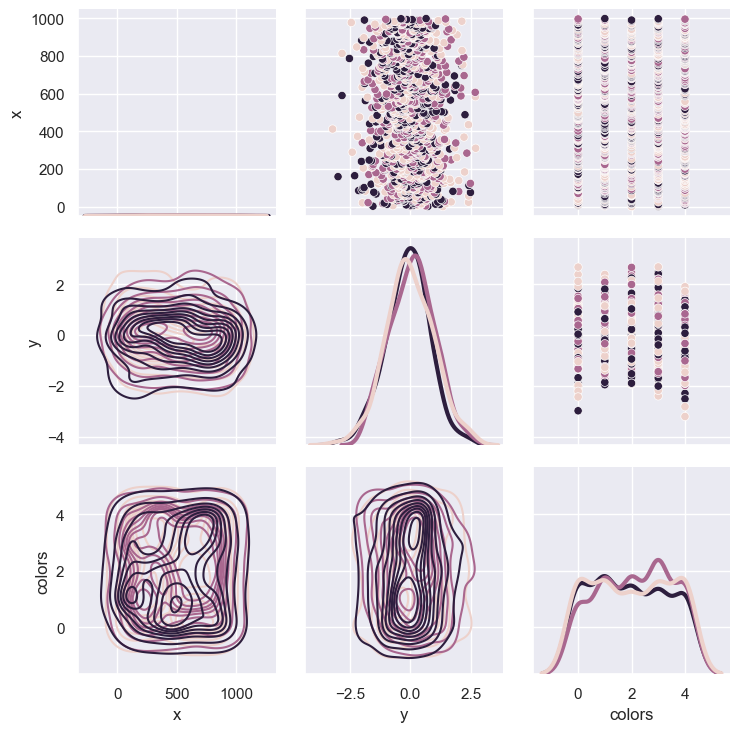

In [286]:
# Contrôle diagonale, partie haute, partie basse
g = sns.PairGrid(df, hue='cat')
g.map_upper(sns.scatterplot)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot, lw=3, legend=False)

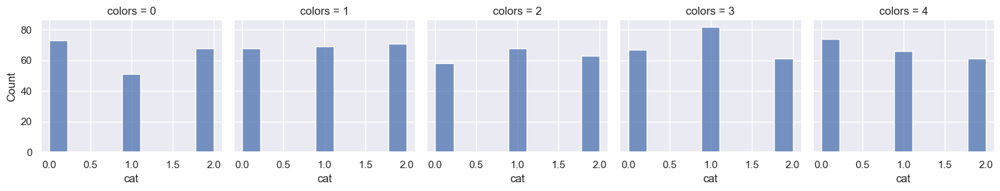

In [287]:
# Pour l'affichage conditionnel d'une même variable
g = sns.FacetGrid(df, col="colors")
g.map(sns.histplot, "cat")

Pour davantage d'exemples et d'explications: https://seaborn.pydata.org/tutorial/axis_grids.html

## Autres types de données: audio, image (2D, 3D)

### Audio

In [314]:
# Download wav file
!wget -q "https://bigsoundbank.com/UPLOAD/wav/0003.wav" -O "data/audio.wav"

data/audio.wav: No such file or directory


ref: https://dev.to/puritye/how-to-plot-an-audio-file-using-matplotlib-pbb

In [320]:
# Load audio file
import wave
obj = wave.open('../src/0003.wav', 'rb')
signal_wave = obj.readframes(-1)
signal_array = np.frombuffer(signal_wave, dtype=np.int16)

In [321]:
# Compute duration and time ticks
print('Parameters:', obj.getparams())
sample_freq = obj.getframerate()
n_samples = obj.getnframes()
duration = n_samples/sample_freq
time = np.linspace(0, duration, num=n_samples)

Parameters: _wave_params(nchannels=1, sampwidth=2, framerate=44100, nframes=559930, comptype='NONE', compname='not compressed')


#### Plot signal wave

Matplotlib

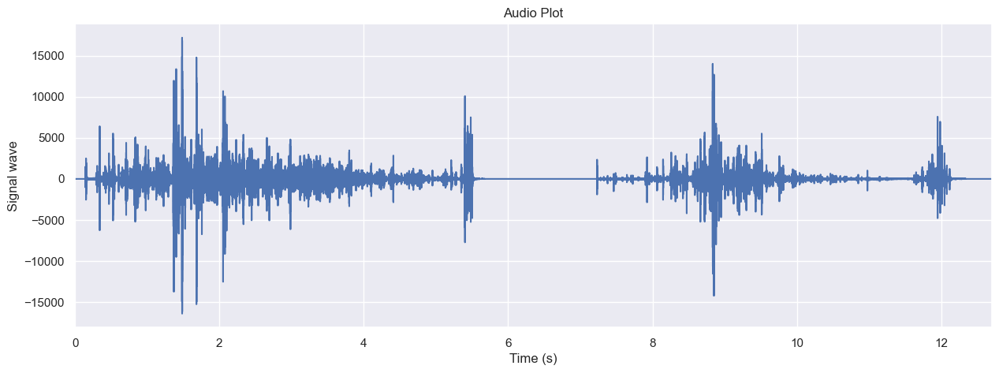

In [322]:
plt.figure(figsize=(15, 5))
plt.plot(time, signal_array)
plt.title('Audio Plot')
plt.ylabel('Signal wave')
plt.xlabel('Time (s)')
plt.xlim(0, max(time))
plt.show()

Seaborn
- N'apporte rien par rapport à matplotlib sur ce type de graph (étant donné que le thème de seaborn est déjà activté pour matplotlib ci-dessus)

Plotly

In [ ]:
fig = go.Figure([go.Scatter(x=time, y=signal_array)])
fig.show()

#### Plot spectrum

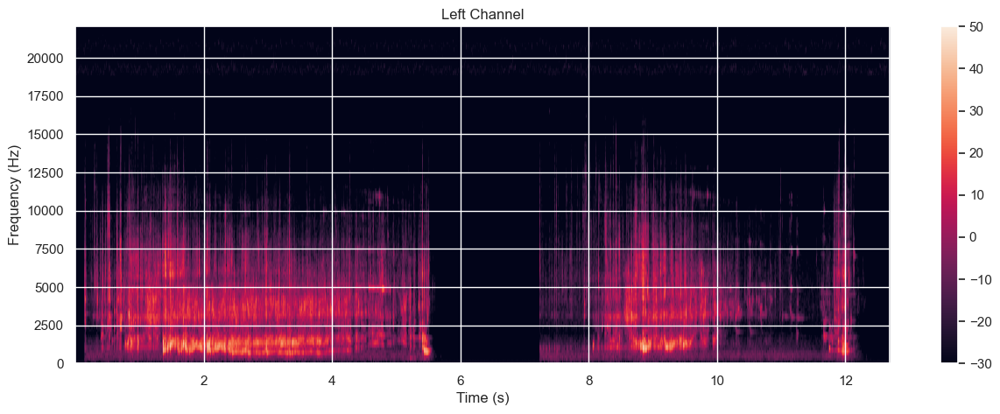

In [ ]:
plt.figure(figsize=(15, 5))
plt.specgram(signal_array, Fs=sample_freq, vmin=-30, vmax=50)
plt.title('Left Channel')
plt.ylabel('Frequency (Hz)')
plt.xlabel('Time (s)')
plt.colorbar()
plt.show()

### Image

#### 2D

In [ ]:
# Download mri image
!wget -q "https://physionet.org/files/images/1.0.0/E1154S7I000.png?download" -O "data/img.png"

In [ ]:
# Load image
import matplotlib.image as mpimg
img = mpimg.imread('data/img.png')

Matplotlib

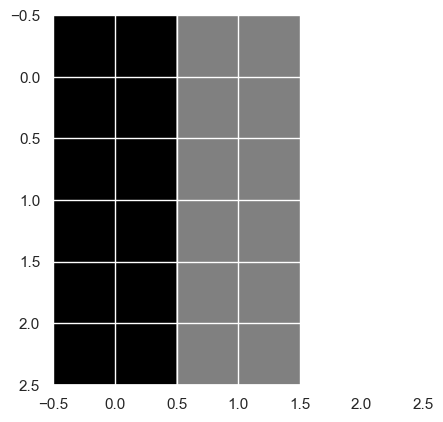

In [323]:
# Utilisatino de imshow
arr = np.array([[1, 2, 3],[1, 2, 3], [1, 2, 3]])
plt.imshow(arr, cmap='gray')

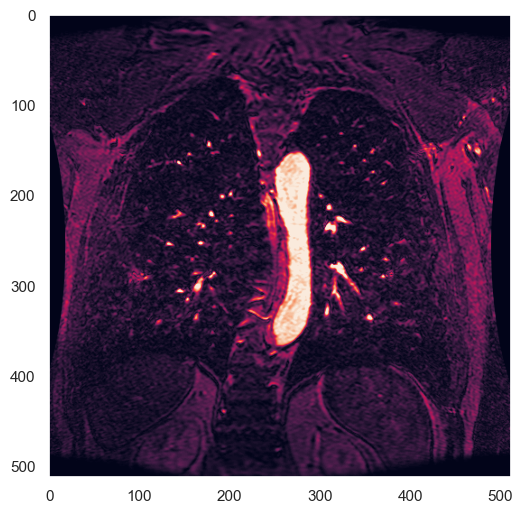

In [ ]:
# Plot image
plt.figure(figsize=(6,6))
plt.grid(visible=None)
plt.imshow(img)

Seaborn

<AxesSubplot:>

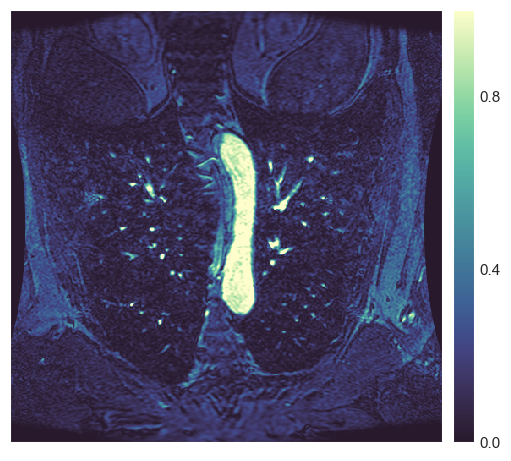

In [ ]:
import seaborn_image as isns
fig, ax = plt.subplots(figsize=(6,6))
isns.imgplot(img, ax=ax)

Plotly

In [ ]:
import plotly.express as px
fig = px.imshow(img)
fig.show()

#### 3D

Matplotlib
- https://jakevdp.github.io/PythonDataScienceHandbook/04.12-three-dimensional-plotting.html

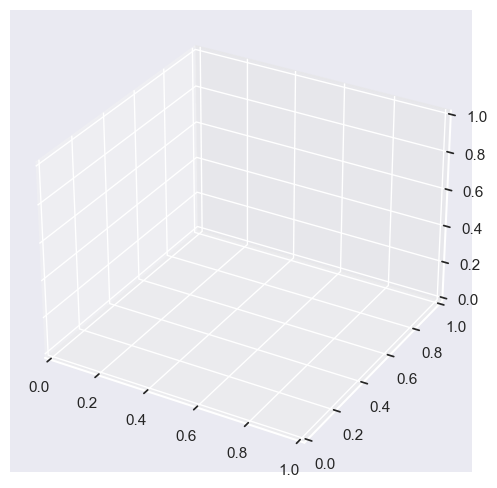

In [ ]:
fig = plt.figure(figsize=(6,6))
ax = plt.axes(projection='3d')

In [ ]:
def f(x, y):
    return np.sin(np.sqrt(x ** 2 + y ** 2))

x = np.linspace(-6, 6, 30)
y = np.linspace(-6, 6, 30)

X, Y = np.meshgrid(x, y)
Z = f(X, Y)

Text(0.5, 0, 'z')

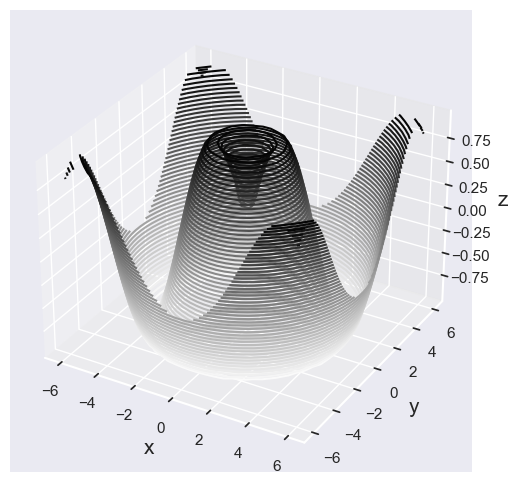

In [ ]:
fig = plt.figure(figsize=(6, 6))
ax = plt.axes(projection='3d')
ax.contour3D(X, Y, Z, 50, cmap='binary')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

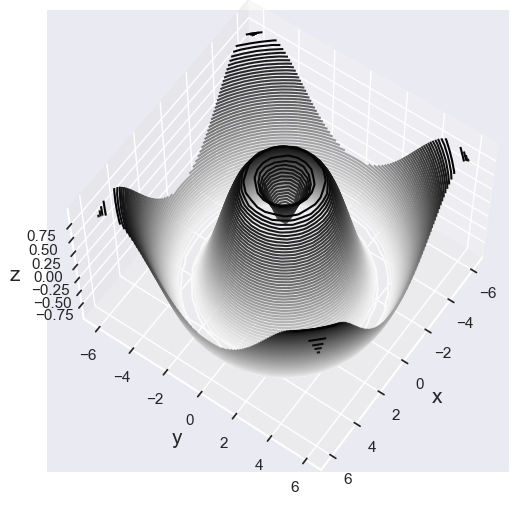

In [ ]:
ax.view_init(60, 35)
fig

Plotly
- https://plotly.com/python/3d-scatter-plots/

In [ ]:
import plotly.express as px
df_iris = px.data.iris()
fig = px.scatter_3d(df_iris, x='sepal_length', y='sepal_width', z='petal_width',
              color='species')
fig.show()

Pour davantage de possibilités
- https://plotly.com/python/visualizing-mri-volume-slices/
- https://dash.gallery/dash-brain-viewer/
- https://dash.gallery/Portal/

## Dessins, annotations

### Lines verticles, horizontales

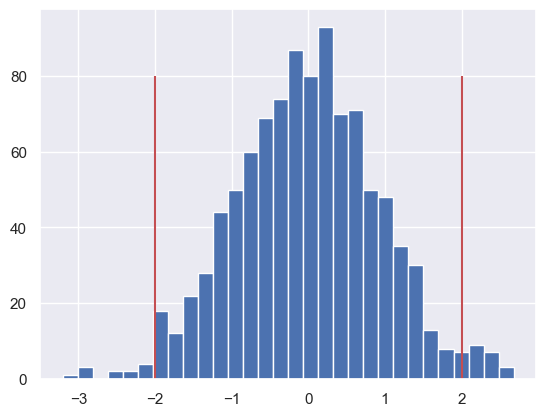

In [355]:
df['y'].hist(bins=30)
plt.vlines([-2, 2], ymin=0, ymax=80, colors='r')

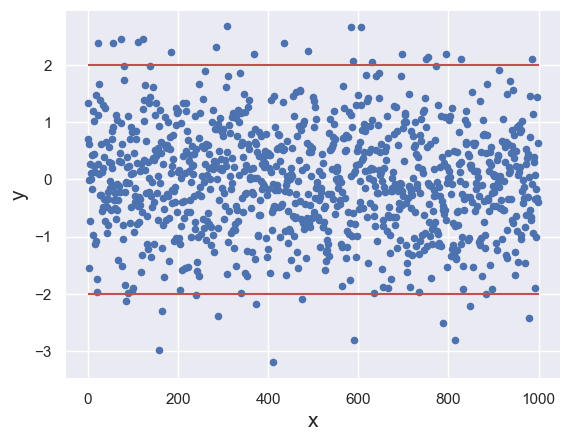

In [ ]:
df.plot.scatter('x', 'y', color='b')
plt.hlines([-2, 2], xmin=0, xmax=1000, color='r')

### Formes

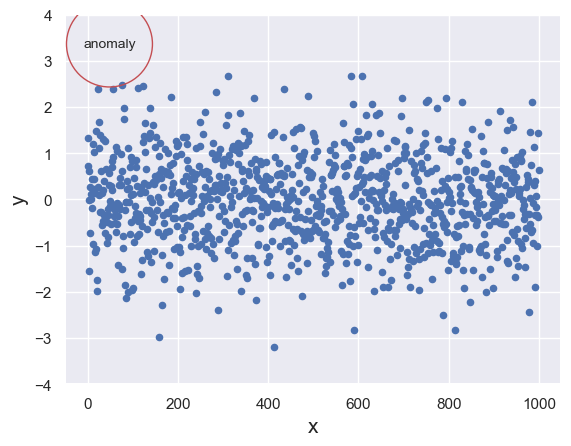

In [ ]:
df.plot.scatter('x', 'y', c='b', ylim=(-4, 4))

# https://matplotlib.org/3.1.1/_images/sphx_glr_whats_new_98_4_fancy_thumb.png
bbox_props = {
    'boxstyle': 'circle', # other type: 'round', 'rarrow', 'larrow', 'darrow', 'lbracket', 'rbracket', 'round4', 'roundtooth', 'sawtooth', 'square', 'squaretooth'
    'pad': 1.2,
    'facecolor': 'none',
    'edgecolor': 'r',
}
plt.annotate("anomaly", (-10, 3.3), bbox = bbox_props, clip_on=True)
plt.show()

### Annotations

#### Fleche manuelle

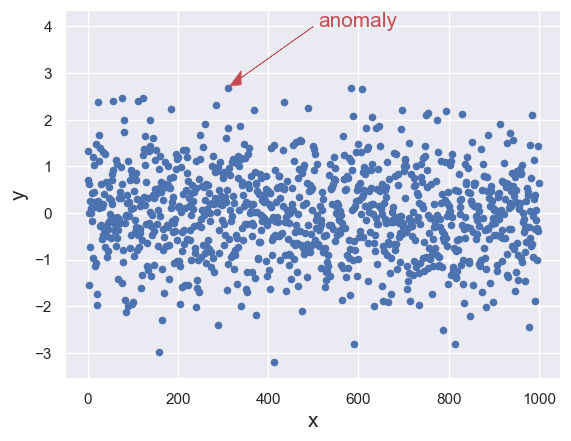

In [ ]:
df.plot.scatter('x', 'y', c='b')

# Position départ de la flêche (x, y), décalage par rapport au point de départ (x, y)
plt.arrow(500, 4, -160, -1.1, head_width=.3, head_length=25, linewidth=.5, color='r')
plt.text(510, 4, "anomaly", color='r', fontsize=15)
plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Text(170, -3.6, '||AB||=253')

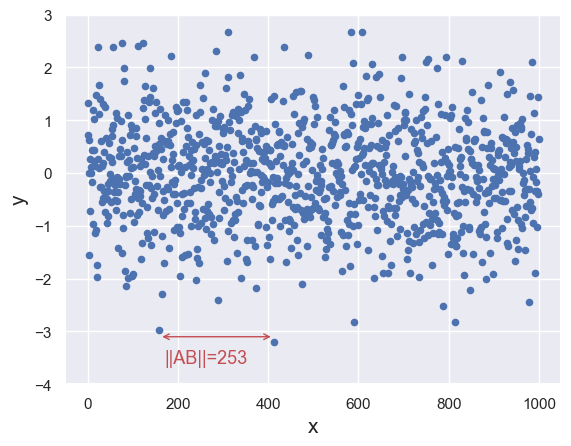

In [ ]:
df.plot.scatter('x', 'y', ylim=(-4, 3))

plt.annotate(text='', xy=(159,-3.1), xytext=(412,-3.1), arrowprops=dict(arrowstyle='<->', color='r'))
plt.text(170, -3.6, "||AB||=253", color='r', fontsize=13)

#### Fleche semi-automatique

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Text(100, 40, '$>1.96\\sigma$')

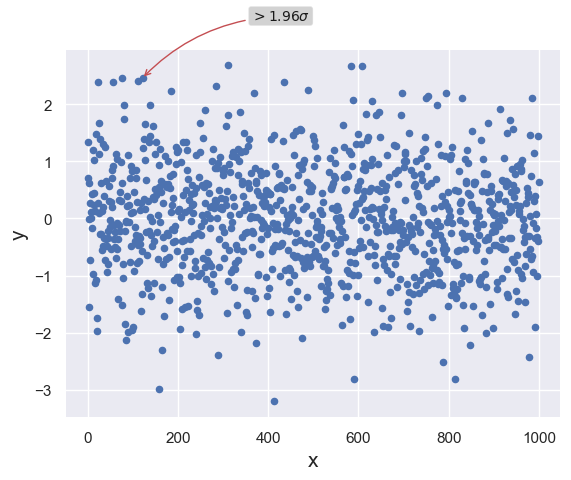

In [ ]:
df.plot.scatter('x', 'y')

# Position point fleche (xy), décalage (x, y%)
plt.annotate(
    r'$>1.96\sigma$', xy=(120, 2.45), xytext=(100,40), 
    textcoords='offset points', ha='center', va='bottom',color='k',
    bbox=dict(boxstyle='round,pad=0.2', fc='grey', alpha=0.35),
    arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.2', 
    color='r'))

In [ ]:
import plotly.graph_objects as go
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=df['x'],
    y=df['y'],
    mode="markers+text",
    name="Markers and Text",
))

fig.add_trace(go.Scatter(
    x=[159, 412],
    y=[-2.979597, -3.204401],
    mode="lines+text",
    name="Lines and Text",
    text=["A", "B"],
    textposition="bottom center"
))


## Export d'un graphique

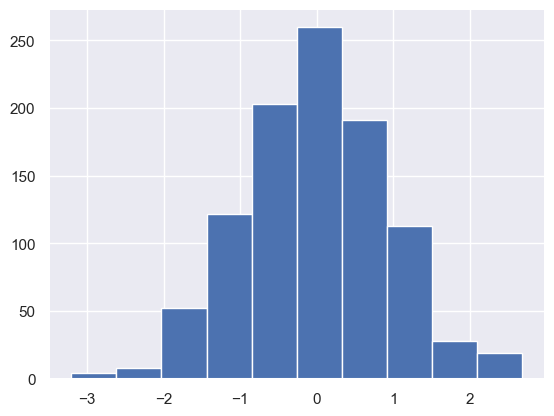

In [ ]:
df['y'].hist()
plt.savefig('hist_y.pdf')
plt.savefig('hist_y.png')

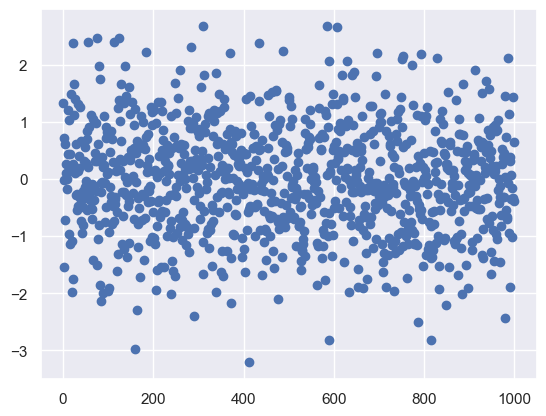

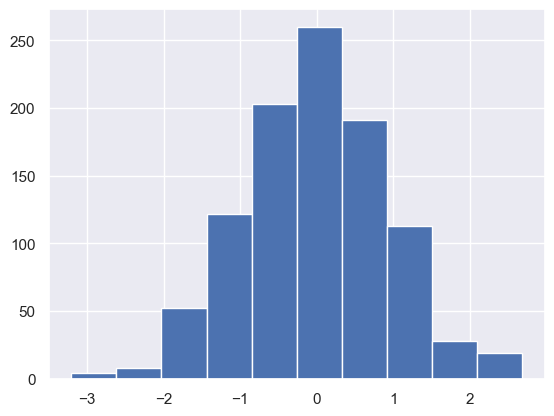

In [359]:
from matplotlib.backends.backend_pdf import PdfPages

with PdfPages('graph_list.pdf') as pdf:
    
    fig = plt.scatter(df['x'], df['y']).get_figure()
    pdf.savefig(fig)
    plt.show()

    fig = df['y'].hist().get_figure()
    pdf.savefig(fig)

## Generation de rapport automatique

In [441]:
from pandas_profiling import ProfileReport

In [442]:
profile = ProfileReport(df_with_na, title="Random data")

In [443]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [444]:
profile.to_file("random_data.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]